# TP1

## Integrantes
1. a1818 Daniel Fernando Peña Pinzon (danielfer.colt01@gmail.com)
2. a1820 Nicolas Pinzon Aparicio	(npinzonaparicio@gmail.com)

## Parte 1 (imágenes en /white_patch y /coord_cromaticas):
1. Implementar el algoritmo de pasaje a coordenadas cromáticas para librarnos de las variaciones de contraste.
2. Implementar el algoritmo White Patch para librarnos de las diferencias de color de iluminación.
3. Mostrar los resultados obtenidos y analizar las posibles fallas (si es que las hay) en el caso de White patch.

### Imports

In [5]:
import numpy as np #1.1 #1.2
import cv2 as cv #1.1 #1.2
import matplotlib.pyplot as plt #1.1 #1.2
import os #1.1 #1.2

Matplotlib is building the font cache; this may take a moment.


### 1.1 Coord cromaticas

Se encontraron 3 imágenes para procesar.

Analizando canales de la imagen original: CoordCrom_1.png


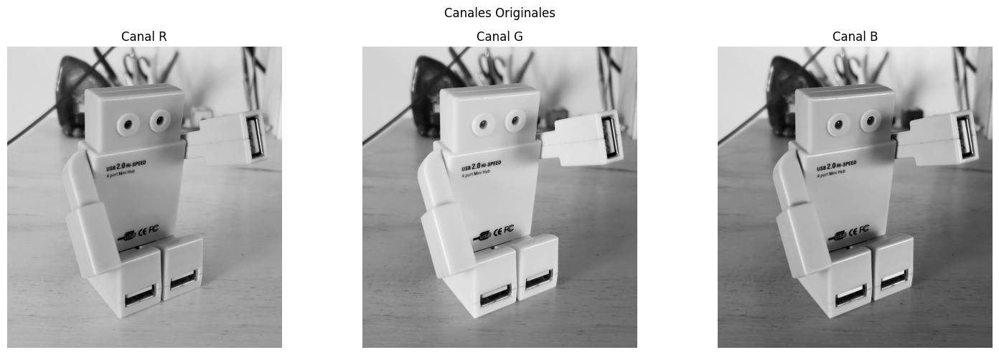

Analizando canales después de aplicar coordenadas cromáticas


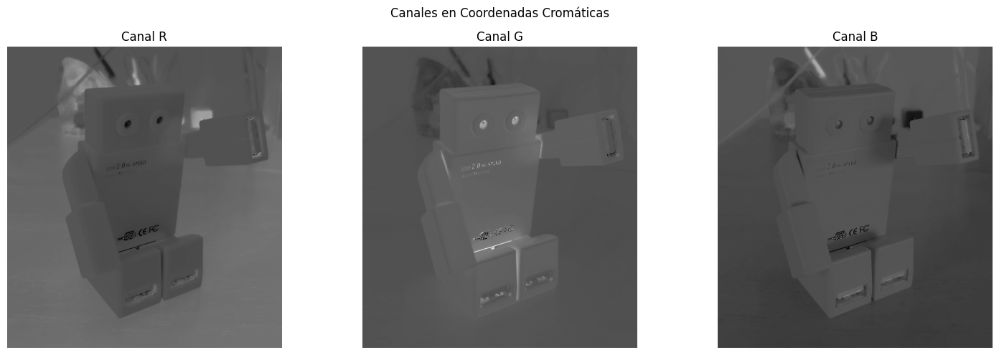

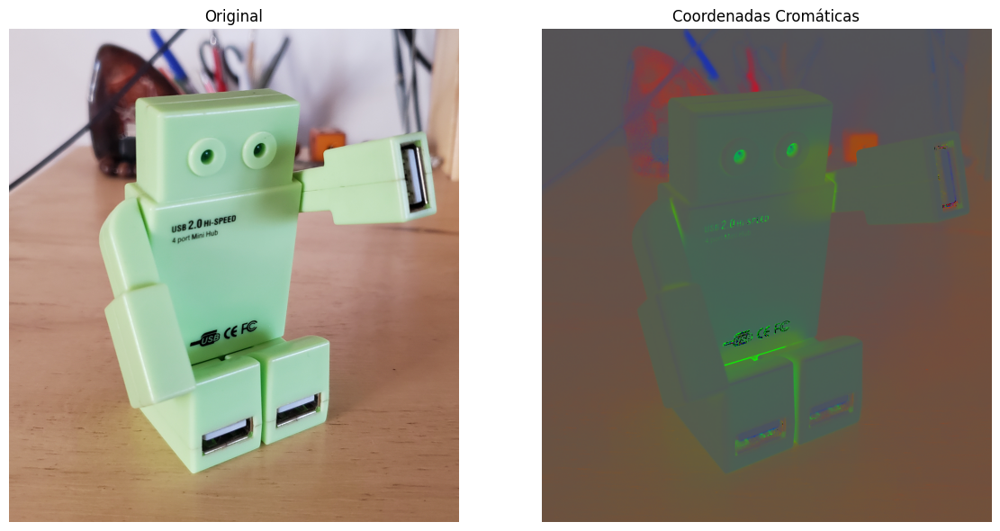

Imagen guardada como: coord_cromaticas/CoordCrom_1_coordenadas_cromaticas.jpg


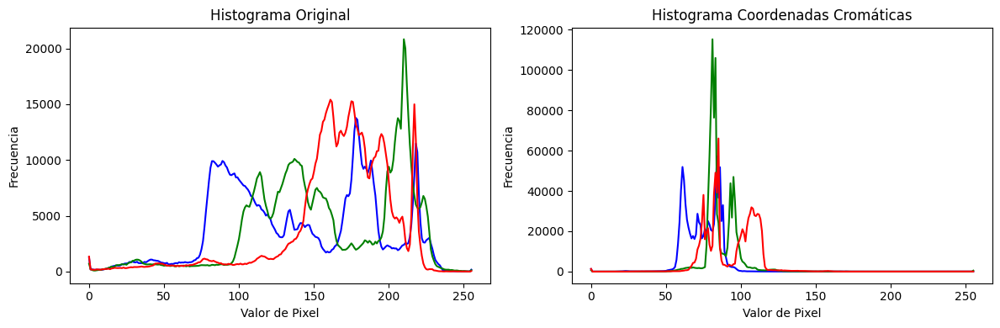


Analizando canales de la imagen original: CoordCrom_2.png


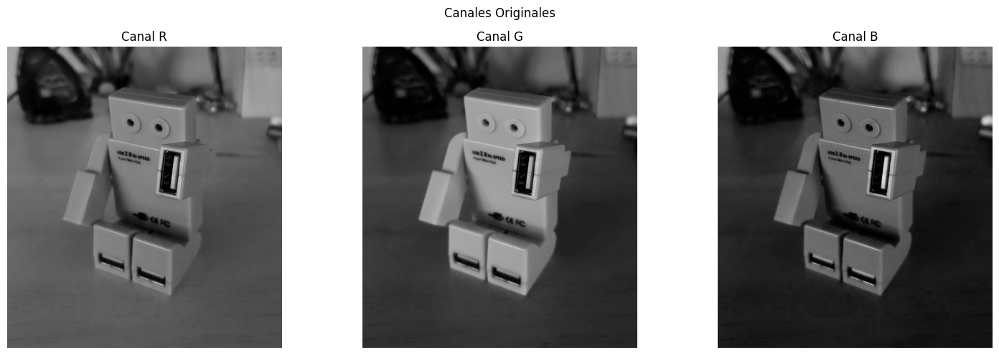

Analizando canales después de aplicar coordenadas cromáticas


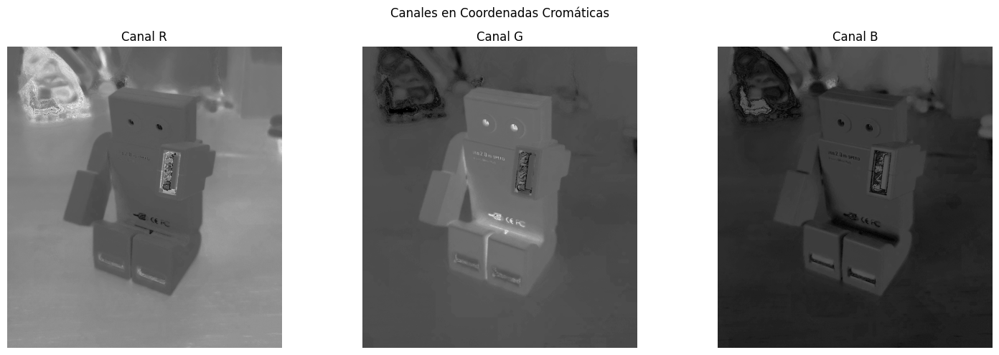

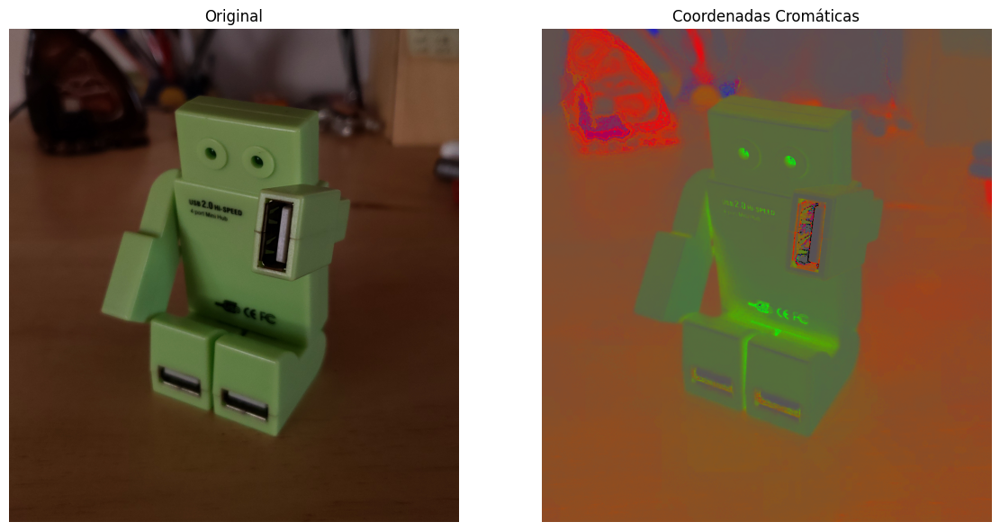

Imagen guardada como: coord_cromaticas/CoordCrom_2_coordenadas_cromaticas.jpg


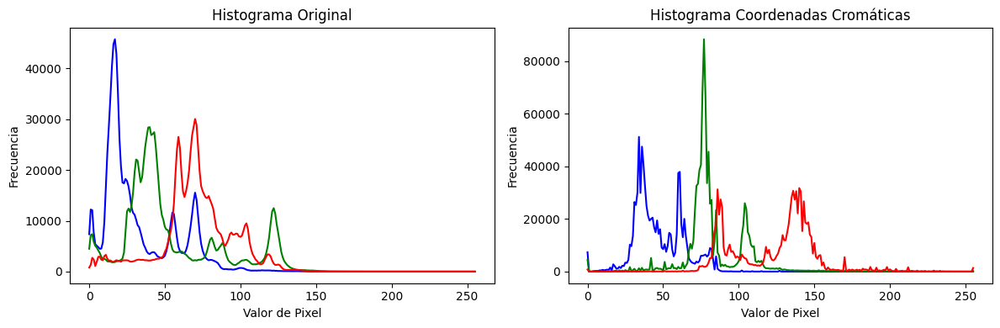


Analizando canales de la imagen original: CoordCrom_3.png


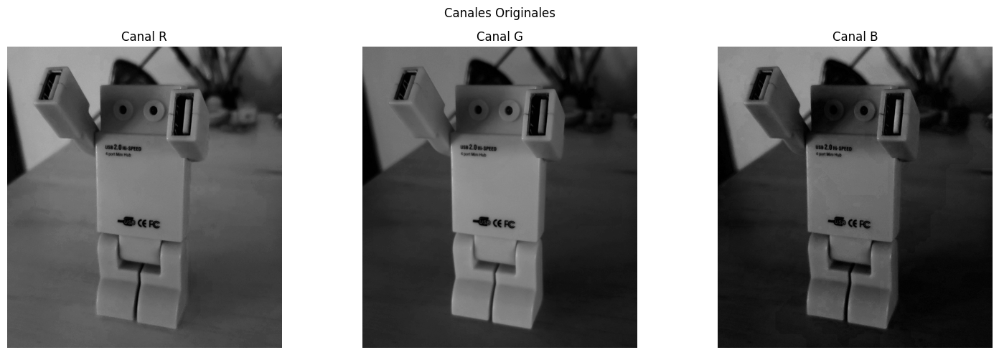

Analizando canales después de aplicar coordenadas cromáticas


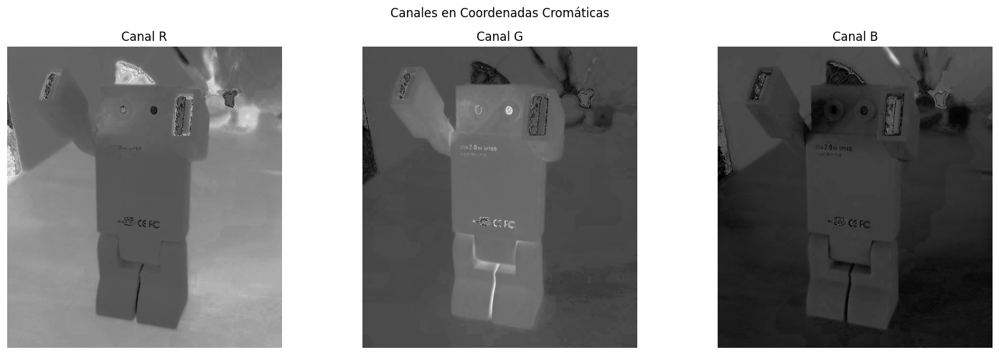

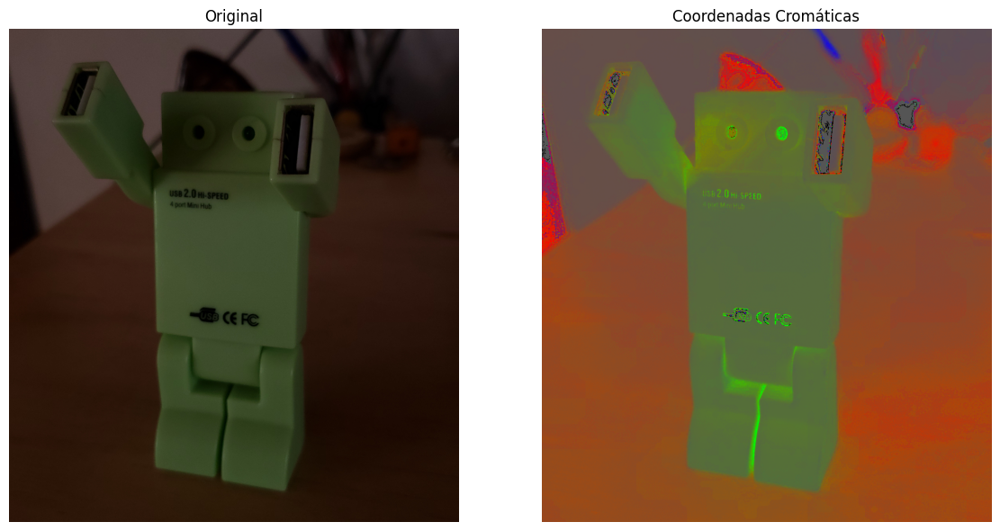

Imagen guardada como: coord_cromaticas/CoordCrom_3_coordenadas_cromaticas.jpg


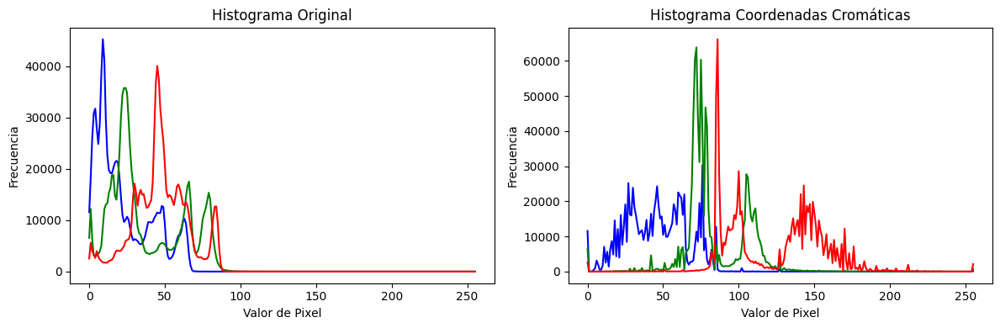


Procesamiento completado.


In [6]:
def rgb_to_chromatic_coordinates(image):
    img_float = image.astype(np.float32)
    b, g, r = cv.split(img_float)
    rgb_sum = r + g + b
    rgb_sum[rgb_sum == 0] = 1e-10

    r_chrom = r / rgb_sum
    g_chrom = g / rgb_sum
    b_chrom = b / rgb_sum

    r_normalized = np.uint8(r_chrom * 255)
    g_normalized = np.uint8(g_chrom * 255)
    b_normalized = np.uint8(b_chrom * 255)

    chromatic_img = cv.merge([b_normalized, g_normalized, r_normalized])

    return chromatic_img

def show_comparison(original, processed, title1="Original", title2="Coordenadas Cromáticas"):
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(cv.cvtColor(original, cv.COLOR_BGR2RGB))
    plt.title(title1)
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv.cvtColor(processed, cv.COLOR_BGR2RGB))
    plt.title(title2)
    plt.axis('off')

    plt.tight_layout()
    plt.show()

def analyze_channels(image, title="Análisis de Canales"):
    b, g, r = cv.split(image)

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(r, cmap='gray')
    plt.title('Canal R')
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(g, cmap='gray')
    plt.title('Canal G')
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(b, cmap='gray')
    plt.title('Canal B')
    plt.axis('off')

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

def process_images(image_files):
    for img_file in image_files:
        img = cv.imread(img_file)
        if img is None:
            print(f"Error: No se pudo cargar la imagen {img_file}")
            continue

        print(f"\nAnalizando canales de la imagen original: {os.path.basename(img_file)}")
        analyze_channels(img, "Canales Originales")

        chromatic_img = rgb_to_chromatic_coordinates(img)

        print(f"Analizando canales después de aplicar coordenadas cromáticas")
        analyze_channels(chromatic_img, "Canales en Coordenadas Cromáticas")

        show_comparison(img, chromatic_img, "Original", "Coordenadas Cromáticas")

        output_filename = os.path.splitext(img_file)[0] + '_coordenadas_cromaticas.jpg'
        cv.imwrite(output_filename, chromatic_img)
        print(f"Imagen guardada como: {output_filename}")

        plt.figure(figsize=(12, 4))

        plt.subplot(1, 2, 1)
        color = ('b', 'g', 'r')
        for i, col in enumerate(color):
            hist = cv.calcHist([img], [i], None, [256], [0, 256])
            plt.plot(hist, color=col)
        plt.title('Histograma Original')
        plt.xlabel('Valor de Pixel')
        plt.ylabel('Frecuencia')

        plt.subplot(1, 2, 2)
        for i, col in enumerate(color):
            hist = cv.calcHist([chromatic_img], [i], None, [256], [0, 256])
            plt.plot(hist, color=col)
        plt.title('Histograma Coordenadas Cromáticas')
        plt.xlabel('Valor de Pixel')
        plt.ylabel('Frecuencia')

        plt.tight_layout()
        plt.show()

def main():
    image_dir = "coord_cromaticas"
    if not os.path.exists(image_dir):
        print(f"Error: El directorio {image_dir} no existe.")

        image_dir = "."
        print(f"Procesando imágenes del directorio actual.")

    image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir)
                  if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if not image_files:
        print(f"No se encontraron imágenes en {image_dir}.")
        return

    print(f"Se encontraron {len(image_files)} imágenes para procesar.")


    process_images(image_files)

    print("\nProcesamiento completado.")

if __name__ == "__main__":
    main()

### 1.2 white patch

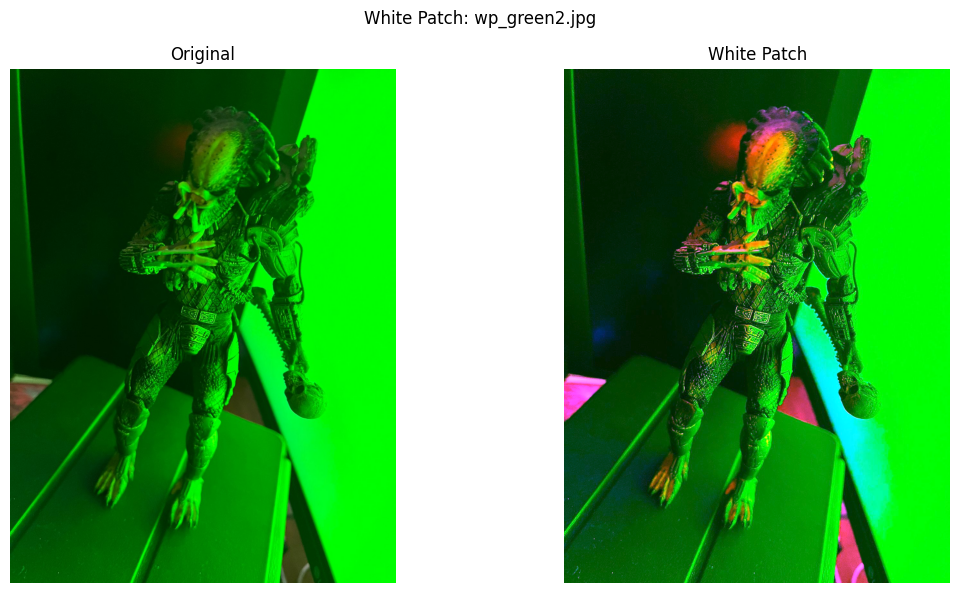

Imagen guardada como: white_patch/wp_green2_white_patch.jpg


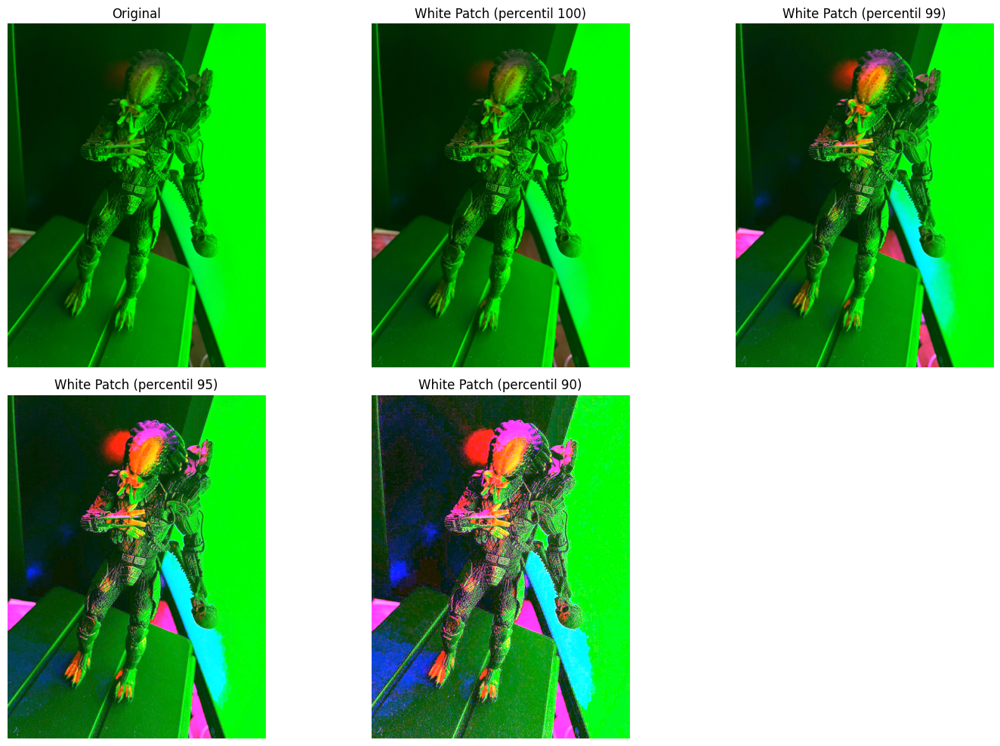

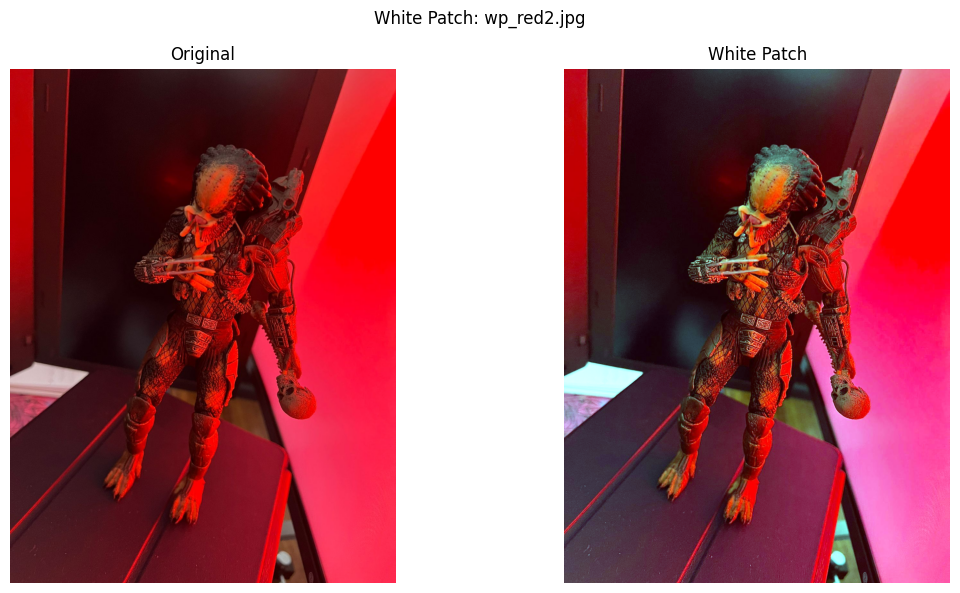

Imagen guardada como: white_patch/wp_red2_white_patch.jpg


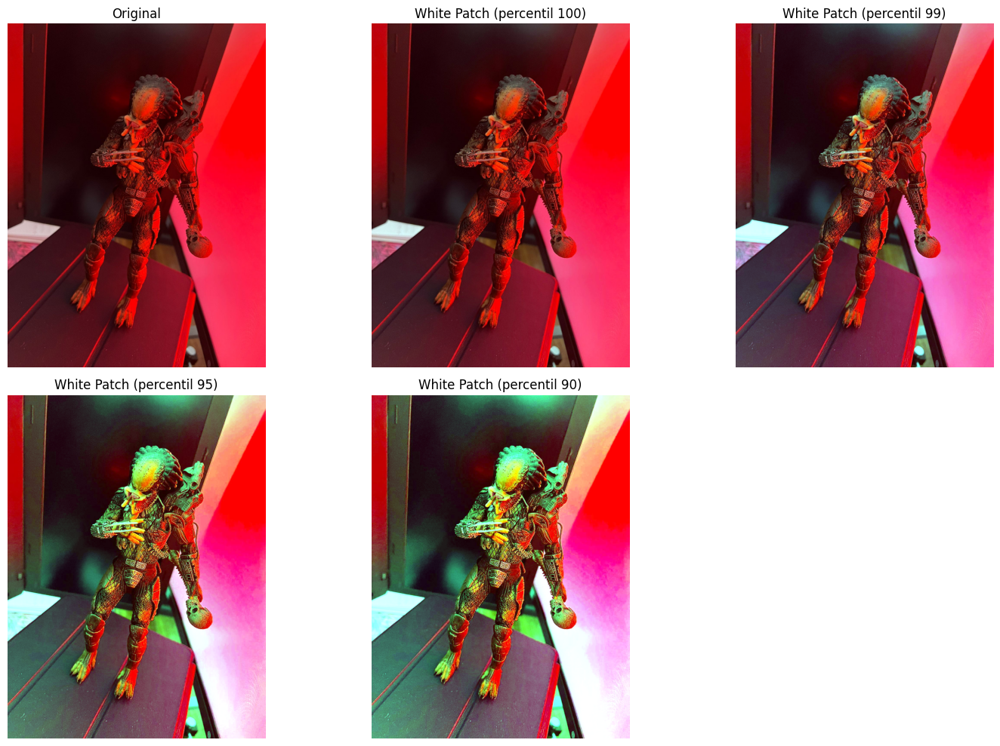

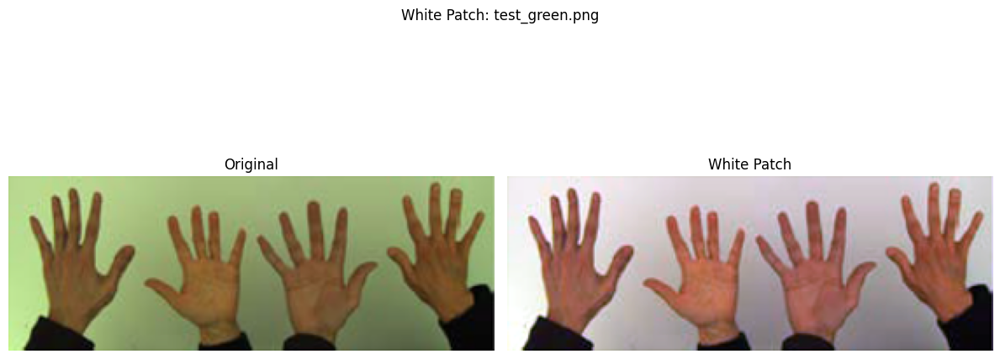

Imagen guardada como: white_patch/test_green_white_patch.jpg


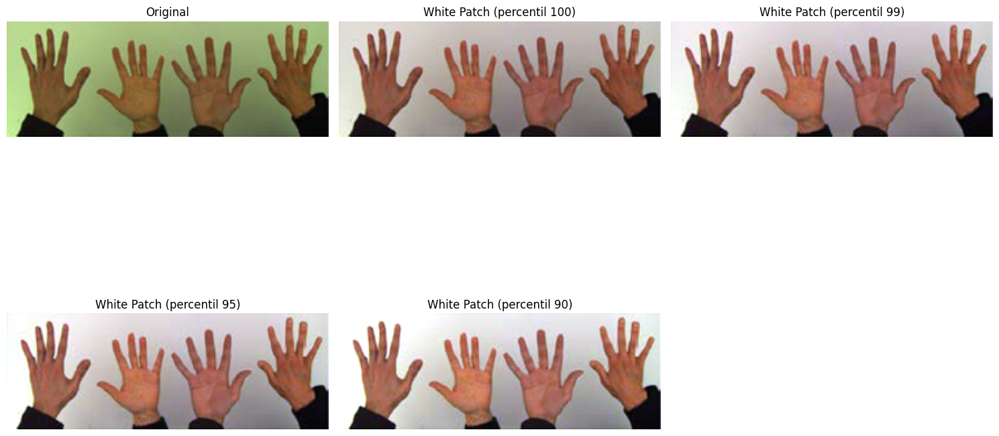

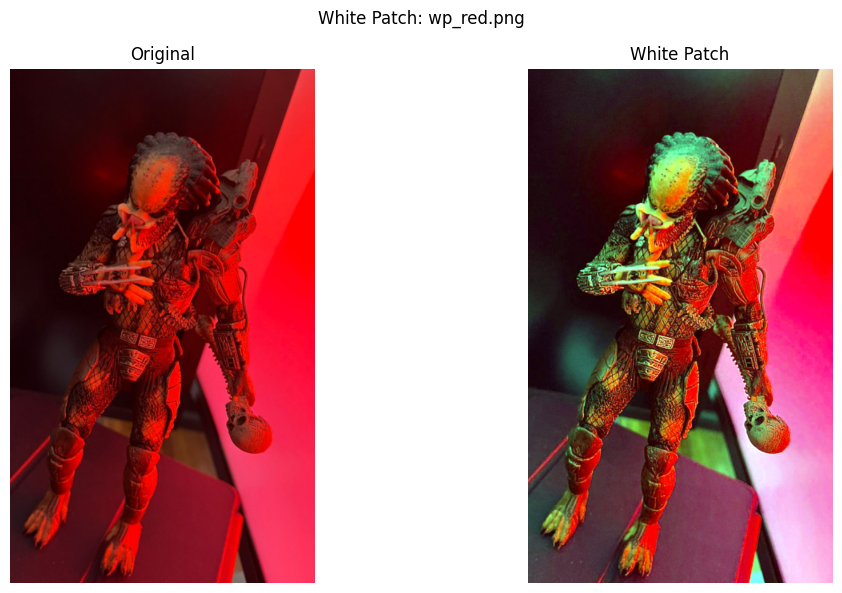

Imagen guardada como: white_patch/wp_red_white_patch.jpg


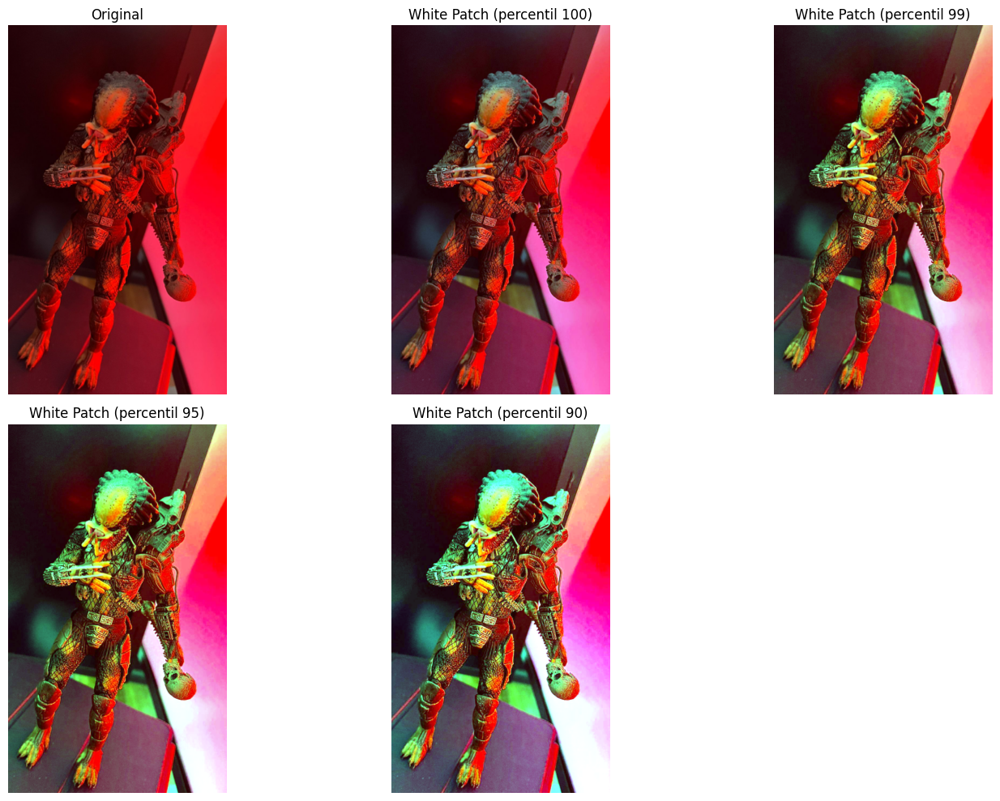

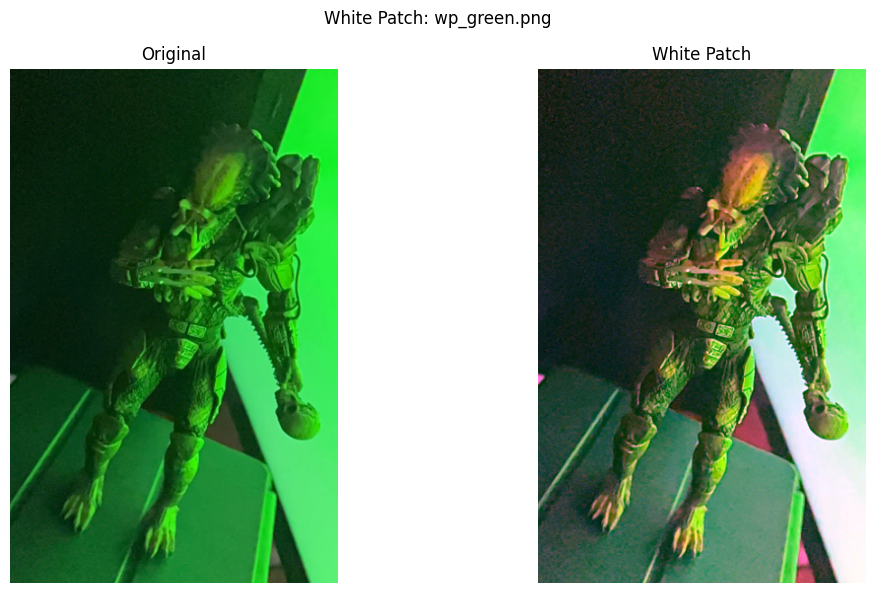

Imagen guardada como: white_patch/wp_green_white_patch.jpg


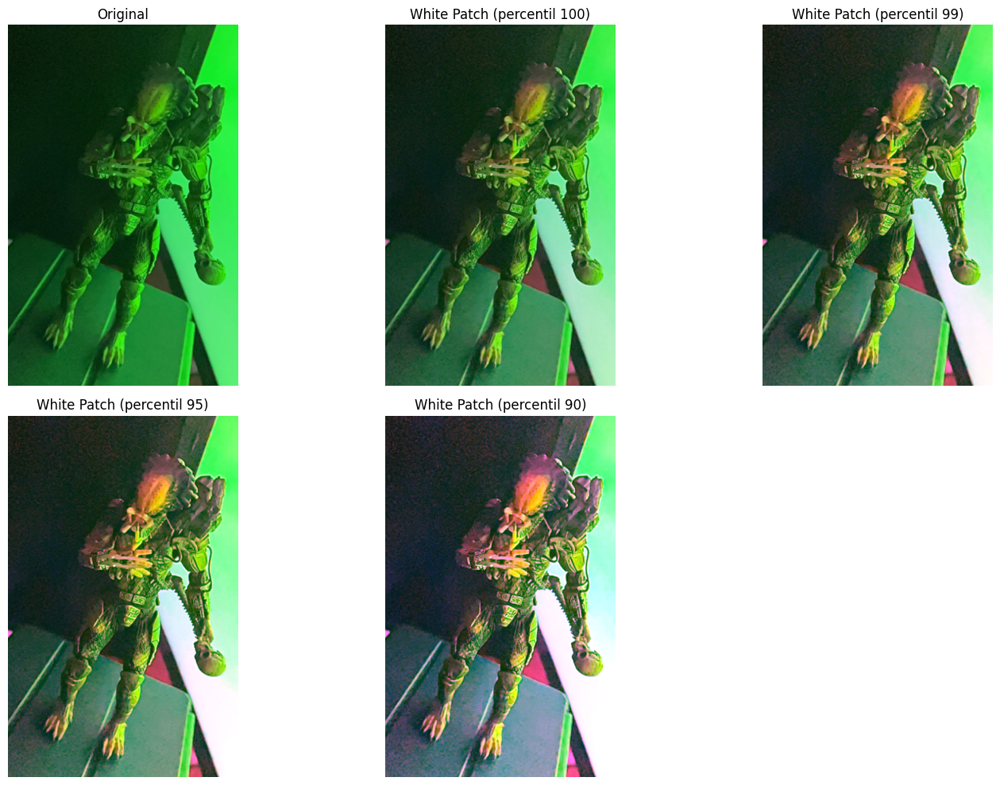

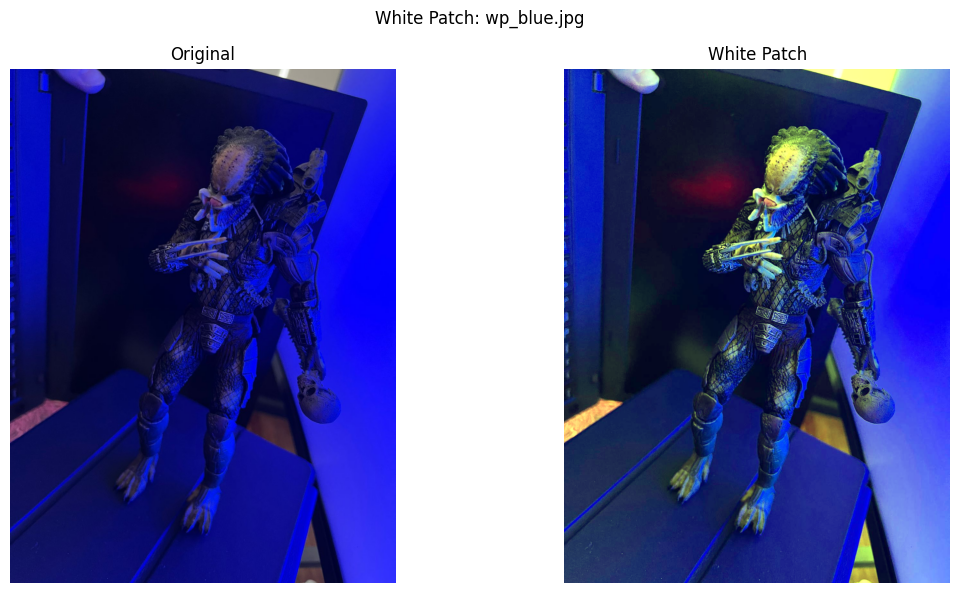

Imagen guardada como: white_patch/wp_blue_white_patch.jpg


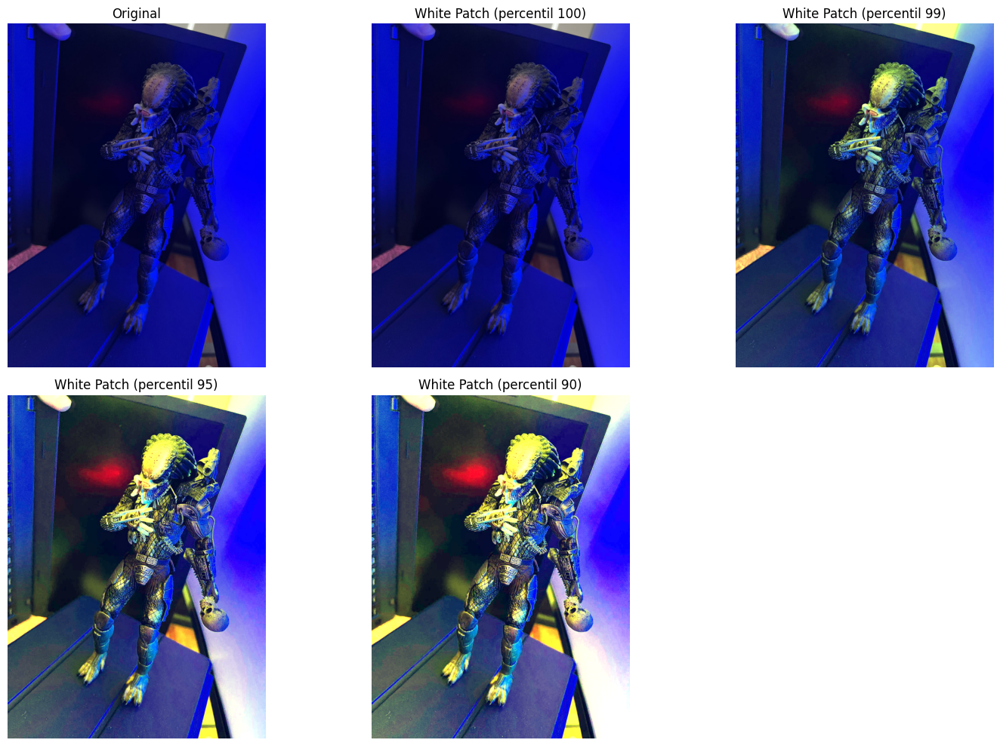

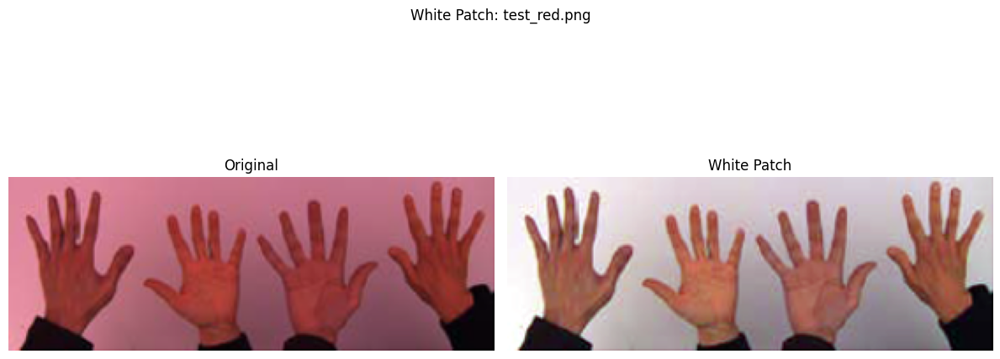

Imagen guardada como: white_patch/test_red_white_patch.jpg


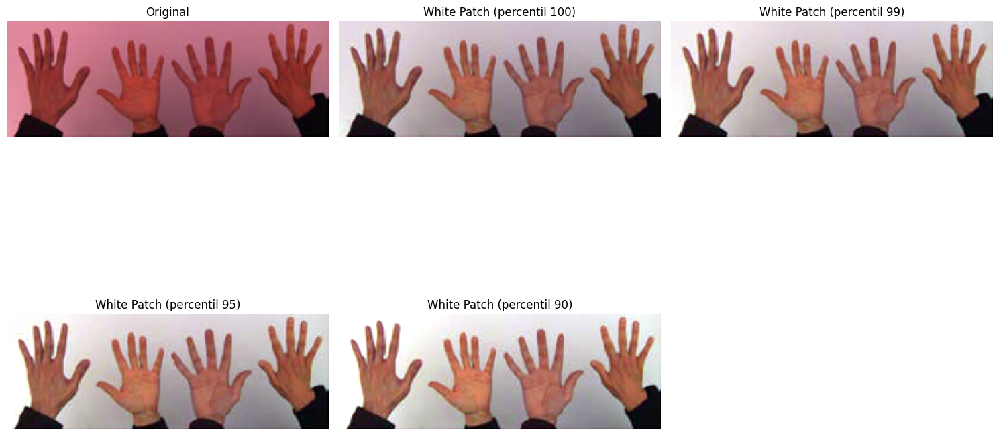

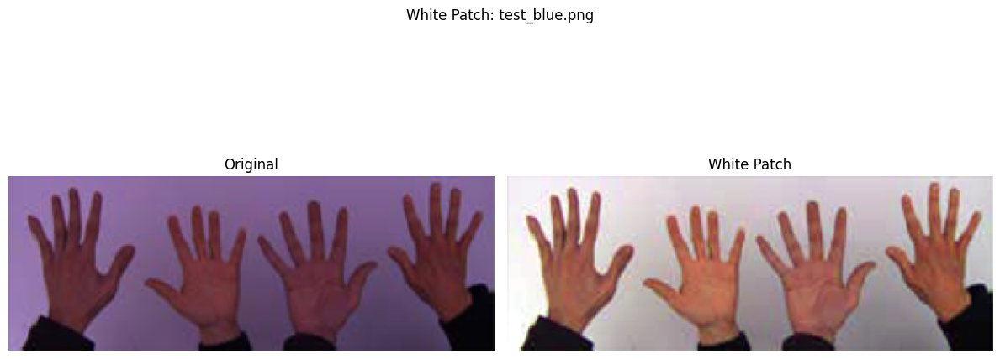

Imagen guardada como: white_patch/test_blue_white_patch.jpg


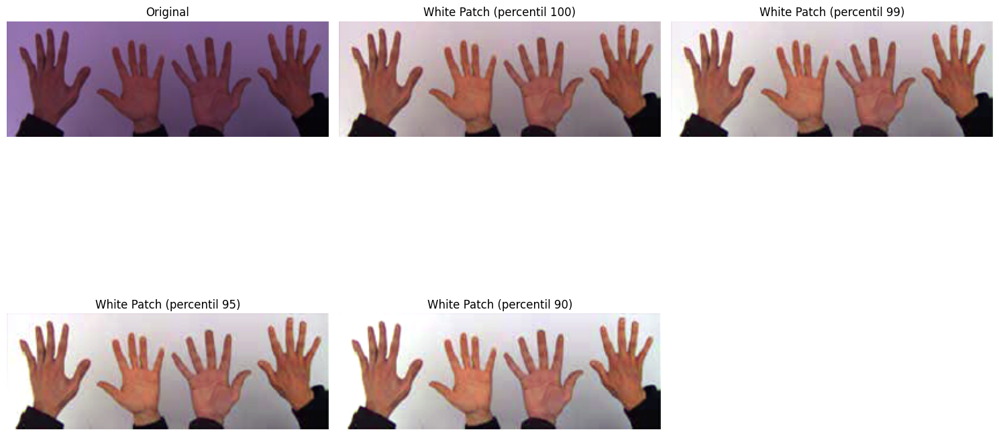

In [7]:
def white_patch(image, percentile=100):
    img_float = image.astype(np.float32)

    b, g, r = cv.split(img_float)

    if percentile < 100:
        b_max = np.percentile(b, percentile)
        g_max = np.percentile(g, percentile)
        r_max = np.percentile(r, percentile)
    else:
        b_max = np.max(b)
        g_max = np.max(g)
        r_max = np.max(r)

    b_max = max(b_max, 1e-10)
    g_max = max(g_max, 1e-10)
    r_max = max(r_max, 1e-10)

    b_normalized = np.clip((b / b_max) * 255, 0, 255)
    g_normalized = np.clip((g / g_max) * 255, 0, 255)
    r_normalized = np.clip((r / r_max) * 255, 0, 255)

    normalized_img = cv.merge([b_normalized, g_normalized, r_normalized])

    normalized_img = normalized_img.astype(np.uint8)

    return normalized_img

def show_comparison(original, corrected, title="Comparación White Patch"):
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.imshow(cv.cvtColor(original, cv.COLOR_BGR2RGB))
    plt.title("Original")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv.cvtColor(corrected, cv.COLOR_BGR2RGB))
    plt.title("White Patch")
    plt.axis('off')

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

def analyze_white_patch(image, percentiles=[100, 99, 95, 90]):
    """
    White Patch con diferentes percentiles.
    """
    results = []

    plt.figure(figsize=(15, 10))

    # Imagen original
    plt.subplot(2, 3, 1)
    rgb_img = cv.cvtColor(image, cv.COLOR_BGR2RGB)
    plt.imshow(rgb_img)
    plt.title("Original")
    plt.axis('off')

    # White Patch con diferentes percentiles
    for i, p in enumerate(percentiles):
        corrected = white_patch(image, p)
        results.append(corrected)

        plt.subplot(2, 3, i+2)
        plt.imshow(cv.cvtColor(corrected, cv.COLOR_BGR2RGB))
        plt.title(f"White Patch (percentil {p})")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    return results

def process_images(image_files, percentile=99):
    for img_file in image_files:
        img = cv.imread(img_file)
        if img is None:
            print(f"No se pudo cargar la imagen: {img_file}")
            continue

        corrected_img = white_patch(img, percentile)

        show_comparison(img, corrected_img, f"White Patch: {os.path.basename(img_file)}")

        output_filename = img_file.rsplit('.', 1)[0] + '_white_patch.jpg'
        cv.imwrite(output_filename, corrected_img)
        print(f"Imagen guardada como: {output_filename}")

        analyze_white_patch(img)

def main():
    image_dir = "white_patch"

    image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir)
                   if f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    process_images(image_files, percentile=99)

if __name__ == "__main__":
    main()

## Parte 2:
1. Para las imágenes img1_tp.png y img2_tp.png leerlas con OpenCV en escala de grisas y visualizarlas.
2. Elija el numero de bins que crea conveniente y grafique su histograma, compare los histogramas entre si.
Explicar lo que se observa, si tuviera que entrenar un modelo de clasificación/detección de imágenes,
considera que puede ser de utilidad tomar como ‘features’ a los histogramas?
3. Para la imagen segmentacion.png analice el histograma de los canales RGB. Segmente algunos de los
elementos presentes en la imagen (agua, cielo, tierra) y muestre, aplicando mascaras, las regiones en imágenes
separadas.

## 2.1 leerlas con OpenCV en escala de grisas y visualizarlas. / 2.2 Graficacion de histograma, comparacion y explicacion.


TP1 - Parte 2: Análisis de Histogramas

1. Cargando y visualizando imágenes en escala de grises...


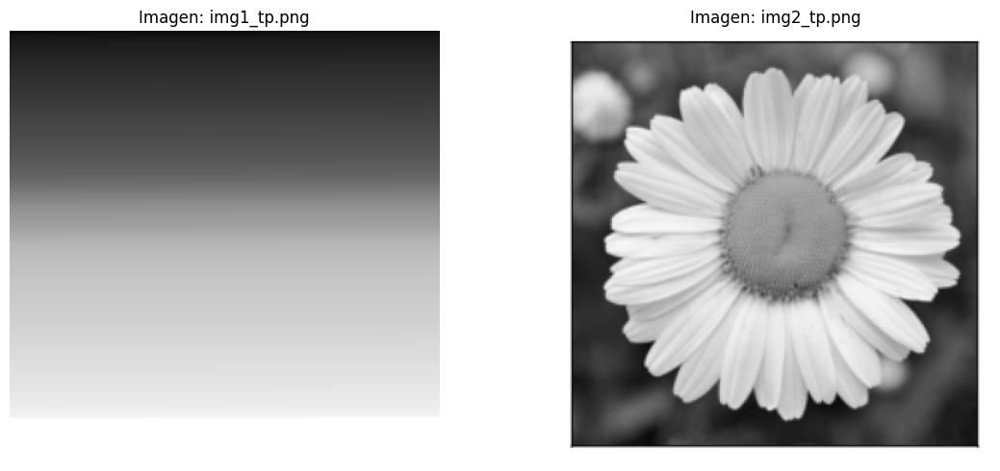


2. Calculando y mostrando histogramas...

Estadísticas de img1_tp.png:
Valor mínimo: 2
Valor máximo: 255
Valor medio: 154.81
Desviación estándar: 75.34

Estadísticas de img2_tp.png:
Valor mínimo: 2
Valor máximo: 255
Valor medio: 154.81
Desviación estándar: 75.34


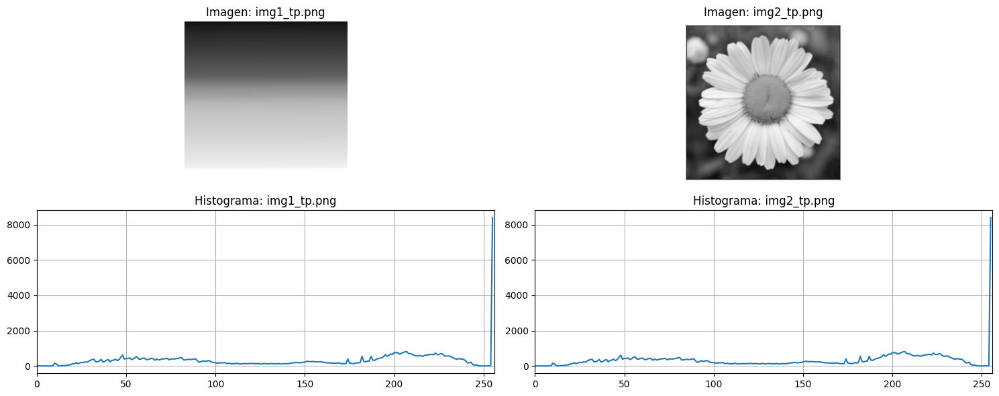


3. Comparando histogramas...


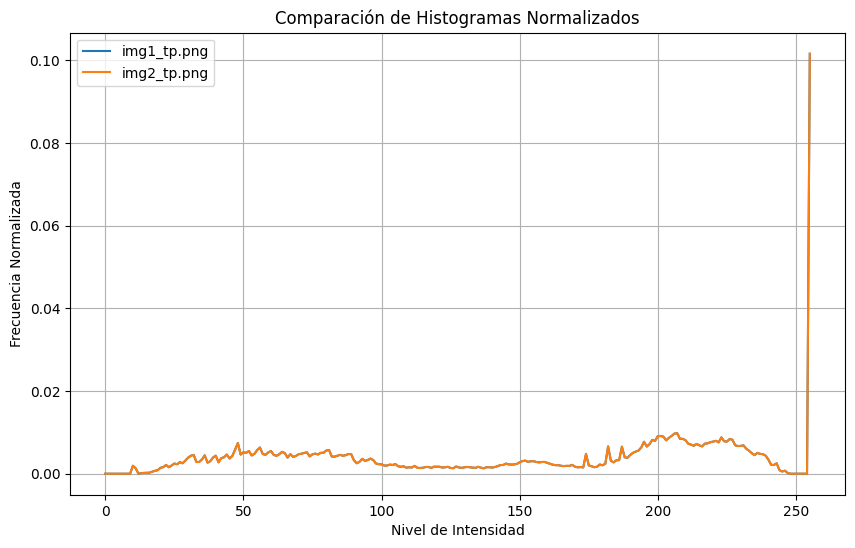


Comparación de histogramas:
Correlación: 1.0000
Chi-Cuadrado: 0.0000
Intersección: 1.0000
Distancia Bhattacharyya: 0.0000

4. Analizando histogramas con diferentes números de bins...

Análisis con 256 bins:


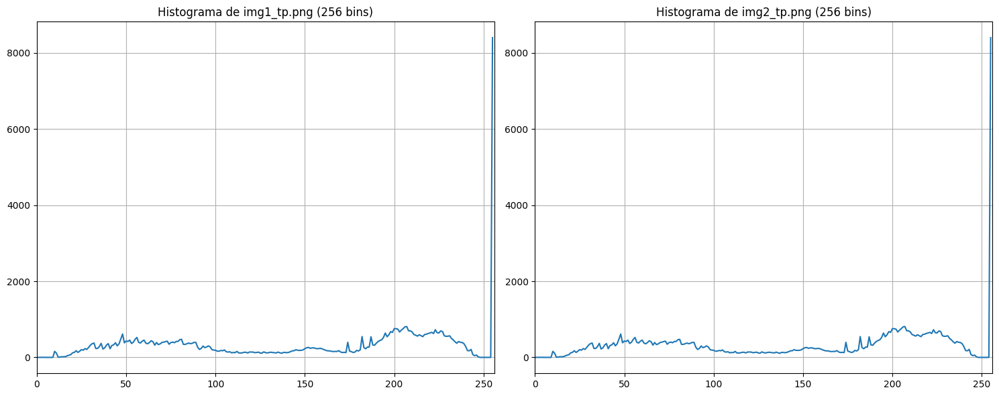


Análisis con 128 bins:


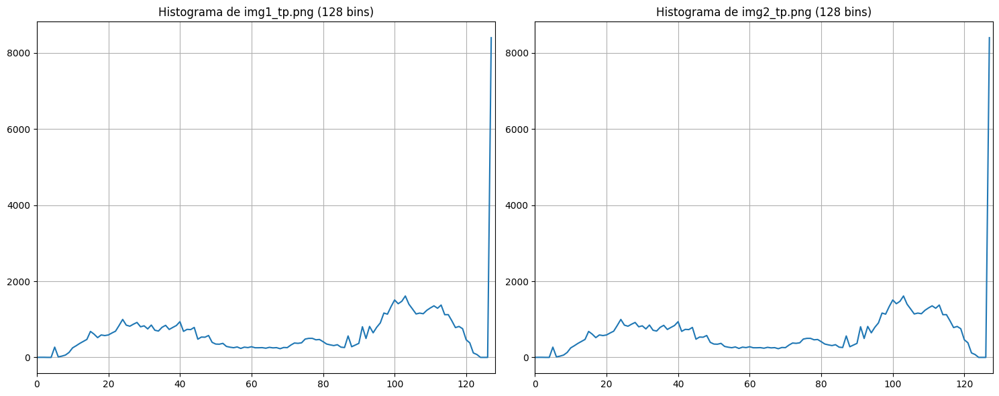


Análisis con 64 bins:


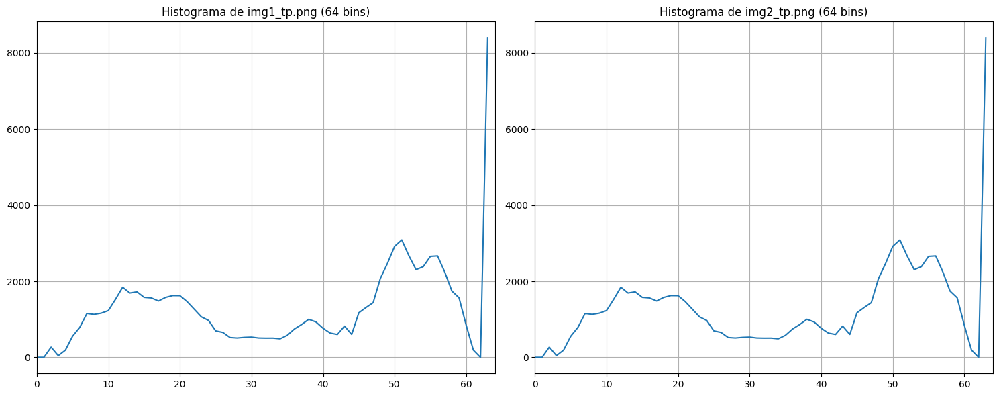


Análisis con 32 bins:


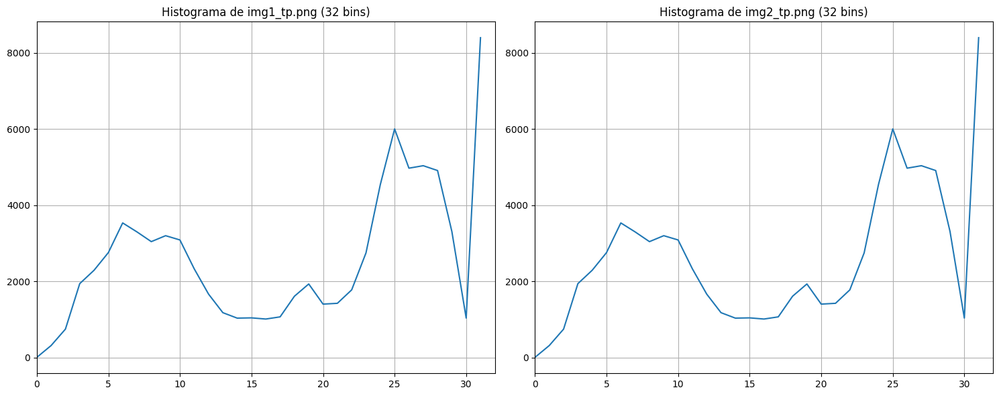


Análisis con 16 bins:


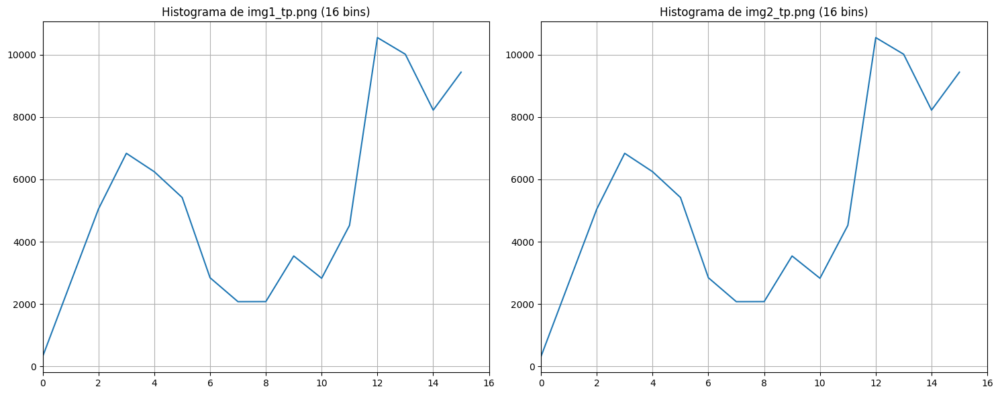


5. Recomendando número óptimo de bins...

Recomendación de número de bins para histogramas:

Imagen: img1_tp.png
Número de píxeles: 82656
Bins según Sturges: 17
Bins según raíz cuadrada: 287
Bins según Rice: 87
Bins según Scott (adaptado): 42


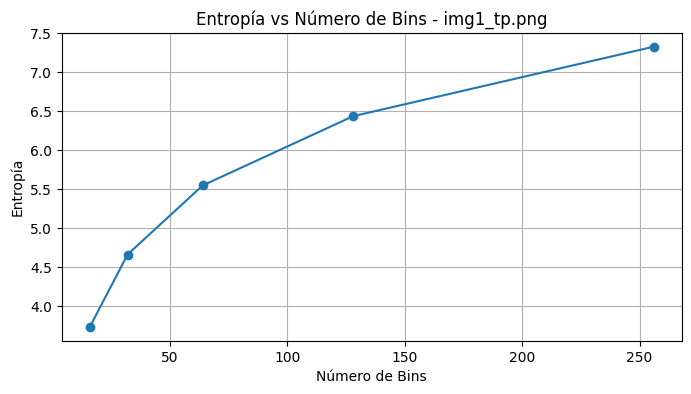

Número óptimo de bins recomendado: 64


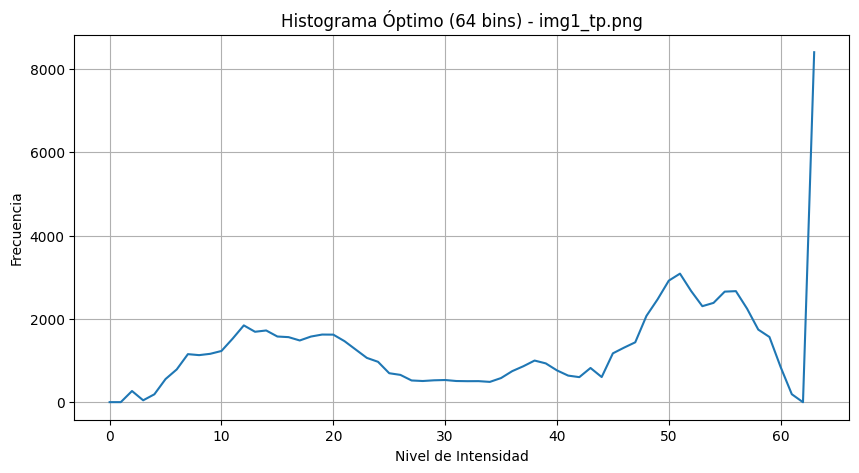


Imagen: img2_tp.png
Número de píxeles: 82656
Bins según Sturges: 17
Bins según raíz cuadrada: 287
Bins según Rice: 87
Bins según Scott (adaptado): 42


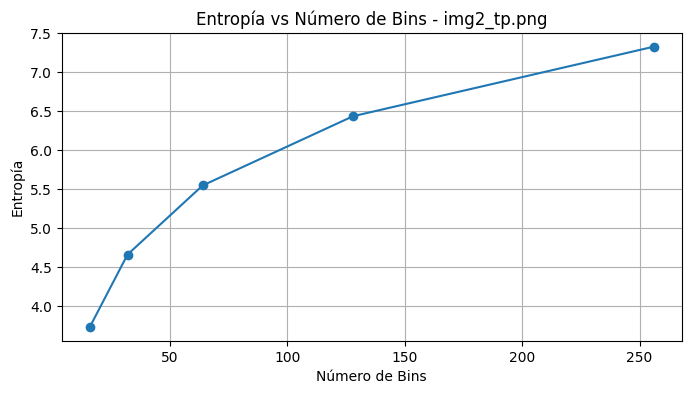

Número óptimo de bins recomendado: 64


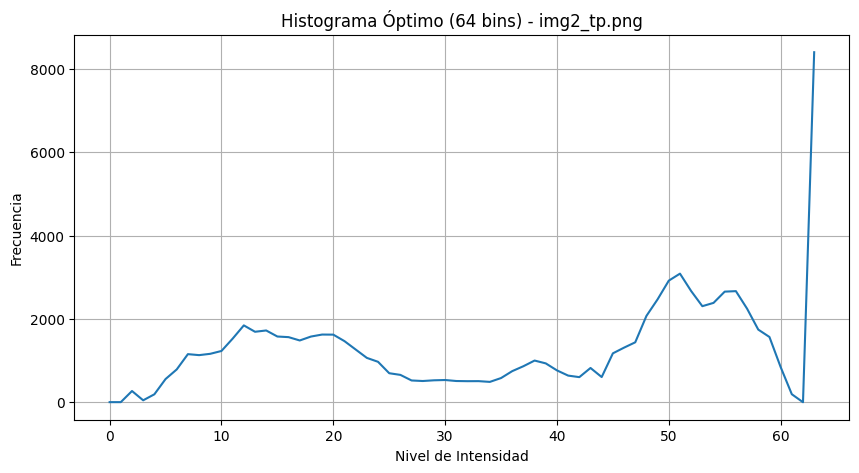


6. Análisis y conclusiones:

    Análisis de los histogramas:
    - La imagen del degradado (img1_tp.png) muestra una distribución relativamente uniforme
      de niveles de gris, típica de un gradiente.
    - La imagen de la flor (img2_tp.png) tiene picos que corresponden a las regiones de los pétalos blancos
      y el fondo más oscuro, mostrando una distribución bimodal o multimodal.

    Selección del número de bins:
    - Un número demasiado alto de bins (256) puede capturar ruido y hacer que el histograma sea sensible
      a pequeñas variaciones, resultando en una representación menos generalizable.
    - Un número demasiado bajo de bins (16) puede perder información importante al agrupar niveles de
      intensidad significativamente diferentes.
    - El número óptimo depende de la distribución de la imagen y la aplicación específica. Para la
      clasificación, valores intermedios (32-64 bins) suelen ofrecer un buen equilibrio entre
      generalización y preservación de inf

In [8]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

def cargar_y_visualizar_imagenes(imagenes):
    imgs_cargadas = []

    plt.figure(figsize=(12, 5))

    for i, img_nombre in enumerate(imagenes):
        img = cv.imread(img_nombre, cv.IMREAD_GRAYSCALE)

        if img is None:
            print(f"Error: No se pudo cargar la imagen {img_nombre}")
            continue

        imgs_cargadas.append(img)

        plt.subplot(1, len(imagenes), i+1)
        plt.imshow(img, cmap='gray')
        plt.title(f"Imagen: {img_nombre}")
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    return imgs_cargadas

def calcular_y_mostrar_histogramas(imagenes, nombres, num_bins=256):
    plt.figure(figsize=(15, 6))

    for i, (img, nombre) in enumerate(zip(imagenes, nombres)):
        plt.subplot(2, len(imagenes), i+1)
        plt.imshow(img, cmap='gray')
        plt.title(f"Imagen: {nombre}")
        plt.axis('off')

        hist = cv.calcHist([img], [0], None, [num_bins], [0, 256])

        plt.subplot(2, len(imagenes), len(imagenes)+i+1)
        plt.plot(hist)
        plt.title(f"Histograma: {nombre}")
        plt.xlim([0, num_bins])
        plt.grid(True)

        print(f"\nEstadísticas de {nombre}:")
        print(f"Valor mínimo: {np.min(img)}")
        print(f"Valor máximo: {np.max(img)}")
        print(f"Valor medio: {np.mean(img):.2f}")
        print(f"Desviación estándar: {np.std(img):.2f}")

    plt.tight_layout()
    plt.show()

def comparar_histogramas(imagenes, nombres, num_bins=256):
    if len(imagenes) < 2:
        print("Se necesitan al menos 2 imágenes para comparar histogramas")
        return

    hists = []
    for img in imagenes:
        hist = cv.calcHist([img], [0], None, [num_bins], [0, 256])
        hist = hist / hist.sum()  # Normalizar
        hists.append(hist)

    plt.figure(figsize=(10, 6))
    for i, (hist, nombre) in enumerate(zip(hists, nombres)):
        plt.plot(hist, label=nombre)

    plt.title("Comparación de Histogramas Normalizados")
    plt.xlabel("Nivel de Intensidad")
    plt.ylabel("Frecuencia Normalizada")
    plt.legend()
    plt.grid(True)
    plt.show()

    metodos = [
        ("Correlación", cv.HISTCMP_CORREL),          # Más alto = más similar (max 1)
        ("Chi-Cuadrado", cv.HISTCMP_CHISQR),         # Más bajo = más similar (min 0)
        ("Intersección", cv.HISTCMP_INTERSECT),      # Más alto = más similar
        ("Distancia Bhattacharyya", cv.HISTCMP_BHATTACHARYYA)  # Más bajo = más similar (min 0)
    ]

    print("\nComparación de histogramas:")
    for nombre_metodo, metodo in metodos:
        # loat32 para la comparación
        h1 = hists[0].astype(np.float32)
        h2 = hists[1].astype(np.float32)

        resultado = cv.compareHist(h1, h2, metodo)
        print(f"{nombre_metodo}: {resultado:.4f}")

def analizar_histogramas_con_diferentes_bins(imagenes, nombres, bins_list=[256, 128, 64, 32, 16]):
    for num_bins in bins_list:
        print(f"\nAnálisis con {num_bins} bins:")

        plt.figure(figsize=(15, 6))

        for i, (img, nombre) in enumerate(zip(imagenes, nombres)):
            hist = cv.calcHist([img], [0], None, [num_bins], [0, 256])

            plt.subplot(1, len(imagenes), i+1)
            plt.plot(hist)
            plt.title(f"Histograma de {nombre} ({num_bins} bins)")
            plt.xlim([0, num_bins])
            plt.grid(True)

        plt.tight_layout()
        plt.show()

def recomendar_numero_bins(imagenes, nombres):
    print("\nRecomendación de número de bins para histogramas:")

    for img, nombre in zip(imagenes, nombres):
        # Número de píxeles
        n = img.size

        # Regla de Sturges: k = 1 + 3.322 * log10(n)
        k_sturges = int(1 + 3.322 * np.log10(n))

        # Regla de la raíz cuadrada: k = sqrt(n)
        k_sqrt = int(np.sqrt(n))

        # Regla de Rice: k = 2 * n^(1/3)
        k_rice = int(2 * n**(1/3))

        # Regla de Scott (adaptada): estimación basada en desviación estándar
        std = np.std(img)
        if std > 0:
            h_scott = 3.5 * std / (n**(1/3))
            k_scott = int(256 / h_scott) if h_scott > 0 else 256
        else:
            k_scott = 256

        print(f"\nImagen: {nombre}")
        print(f"Número de píxeles: {n}")
        print(f"Bins según Sturges: {k_sturges}")
        print(f"Bins según raíz cuadrada: {k_sqrt}")
        print(f"Bins según Rice: {k_rice}")
        print(f"Bins según Scott (adaptado): {k_scott}")

        bins_test = [16, 32, 64, 128, 256]
        entropias = []

        for bins in bins_test:
            hist = cv.calcHist([img], [0], None, [bins], [0, 256])
            hist = hist / hist.sum()  # Normalizar

            hist_no_zeros = hist[hist > 0]
            entropia = -np.sum(hist_no_zeros * np.log2(hist_no_zeros))
            entropias.append(entropia)

        # entropía vs número de bins
        plt.figure(figsize=(8, 4))
        plt.plot(bins_test, entropias, 'o-')
        plt.title(f"Entropía vs Número de Bins - {nombre}")
        plt.xlabel("Número de Bins")
        plt.ylabel("Entropía")
        plt.grid(True)
        plt.show()

        # Encontrar número óptimo basado en "codo" de la curva de entropía
        diferencias = np.diff(entropias)
        codo_idx = np.argmin(diferencias) + 1  # +1 porque diff reduce el tamaño en 1
        bins_optimo = bins_test[codo_idx]

        print(f"Número óptimo de bins recomendado: {bins_optimo}")

        # Histograma con el número óptimo de bins
        plt.figure(figsize=(10, 5))
        hist_optimo = cv.calcHist([img], [0], None, [bins_optimo], [0, 256])
        plt.plot(hist_optimo)
        plt.title(f"Histograma Óptimo ({bins_optimo} bins) - {nombre}")
        plt.xlabel("Nivel de Intensidad")
        plt.ylabel("Frecuencia")
        plt.grid(True)
        plt.show()

def main():
    nombres_imagenes = ["img1_tp.png", "img2_tp.png"]

    print("TP1 - Parte 2: Análisis de Histogramas")

    print("\n1. Cargando y visualizando imágenes en escala de grises...")
    imagenes = cargar_y_visualizar_imagenes(nombres_imagenes)

    if len(imagenes) == 0:
        print("No se pudieron cargar las imágenes. Verifique los nombres y las rutas.")
        return

    print("\n2. Calculando y mostrando histogramas...")
    calcular_y_mostrar_histogramas(imagenes, nombres_imagenes)

    print("\n3. Comparando histogramas...")
    comparar_histogramas(imagenes, nombres_imagenes)

    print("\n4. Analizando histogramas con diferentes números de bins...")
    analizar_histogramas_con_diferentes_bins(imagenes, nombres_imagenes)

    print("\n5. Recomendando número óptimo de bins...")
    recomendar_numero_bins(imagenes, nombres_imagenes)

    print("\n6. Análisis y conclusiones:")
    print("""
    Análisis de los histogramas:
    - La imagen del degradado (img1_tp.png) muestra una distribución relativamente uniforme
      de niveles de gris, típica de un gradiente.
    - La imagen de la flor (img2_tp.png) tiene picos que corresponden a las regiones de los pétalos blancos
      y el fondo más oscuro, mostrando una distribución bimodal o multimodal.

    Selección del número de bins:
    - Un número demasiado alto de bins (256) puede capturar ruido y hacer que el histograma sea sensible
      a pequeñas variaciones, resultando en una representación menos generalizable.
    - Un número demasiado bajo de bins (16) puede perder información importante al agrupar niveles de
      intensidad significativamente diferentes.
    - El número óptimo depende de la distribución de la imagen y la aplicación específica. Para la
      clasificación, valores intermedios (32-64 bins) suelen ofrecer un buen equilibrio entre
      generalización y preservación de información discriminativa.

    Utilidad de los histogramas como features para clasificación/detección:

    Ventajas:
    - Invarianza a transformaciones geométricas: Los histogramas son invariantes a rotación, traslación
      y cambios de escala, lo que es valioso para reconocer objetos independientemente de su posición.
    - Compacidad: Reducen una imagen de miles/millones de píxeles a unas decenas o cientos de valores.
    - Simplicidad computacional: Son rápidos de calcular y comparar.

    Limitaciones:
    - Pérdida de información espacial: Dos imágenes muy diferentes pueden tener histogramas similares.
      Por ejemplo, una imagen completamente desordenada podría tener el mismo histograma que una imagen
      estructurada si tienen la misma distribución de intensidades.
    - Sensibilidad a cambios de iluminación: Los histogramas de imágenes sin normalizar cambian
      significativamente con variaciones en la iluminación.
    - Ambigüedad: No capturan relaciones espaciales entre características.

    Conclusión sobre su utilidad:
    Los histogramas pueden ser útiles como features complementarios dentro de un conjunto más amplio
    de características, especialmente cuando:
    - Se combinan con descriptores que capturan información espacial (como HOG, SIFT, etc.)
    - Se aplican a regiones específicas de la imagen (histogramas locales)
    - Se utilizan técnicas de normalización para reducir sensibilidad a cambios de iluminación
    - Se implementan variantes más avanzadas como histogramas de gradientes orientados o histogramas de
      color en espacios perceptualmente uniformes

    Para el caso particular de las imágenes analizadas, los histogramas serían más útiles para la
    clasificación de la imagen de la flor (que tiene una distribución de intensidades más característica)
    que para la imagen del degradado (que tiene una distribución más uniforme y menos distintiva).
    """)

if __name__ == "__main__":
    main()

### 2.3 analizis de histograma de los canales de RGB

TP1 - Parte 2.3: Segmentación de Elementos

1. Cargando y visualizando imagen...


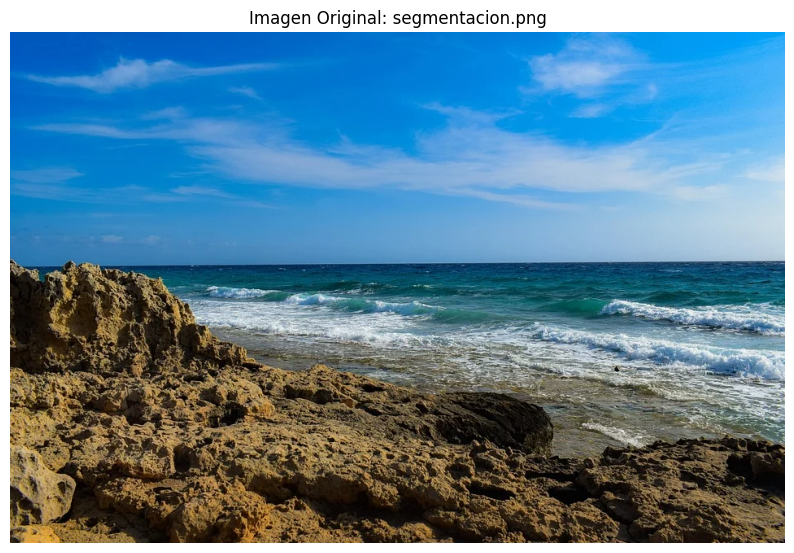


2. Analizando histogramas RGB...


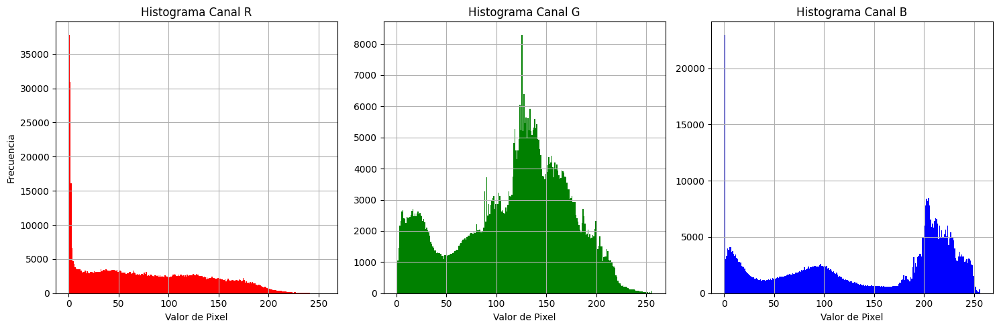

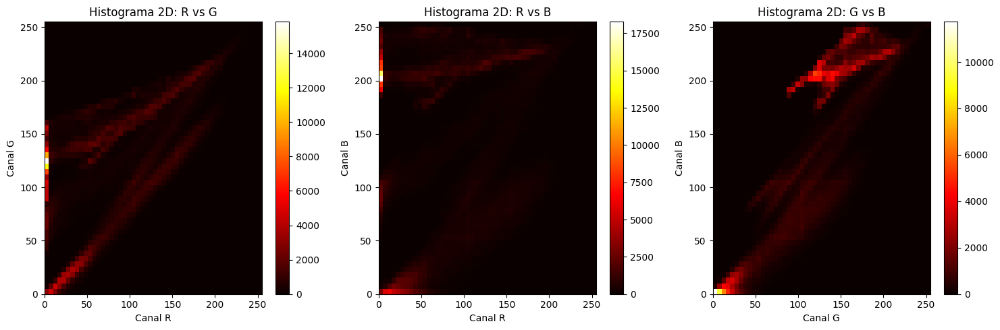

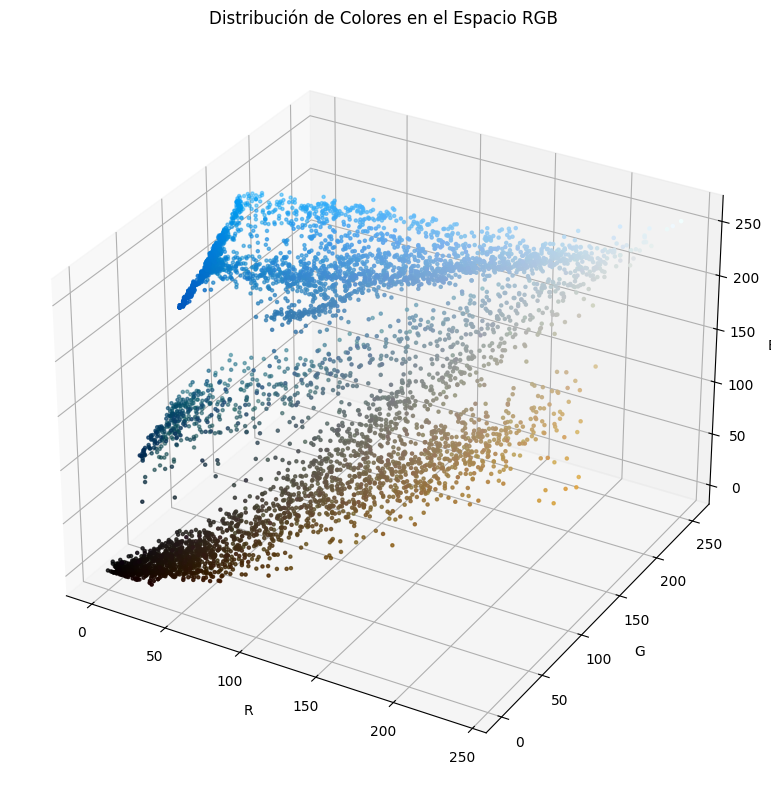


3. Segmentando elementos (agua, cielo, tierra)...

4. Mostrando resultados de la segmentación...


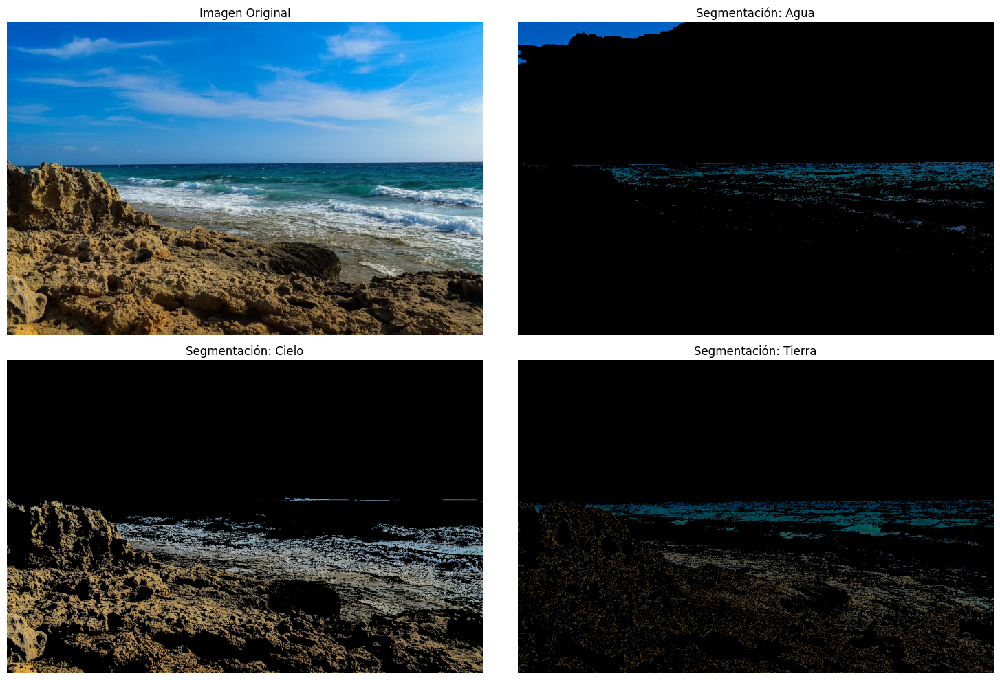

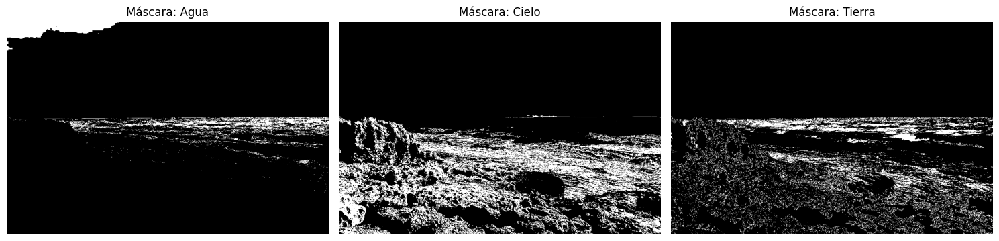


Segmentación completada.


In [10]:
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import os

def cargar_y_visualizar_imagen(imagen_path):
    img = cv.imread(imagen_path)

    if img is None:
        print(f"Error: No se pudo cargar la imagen {imagen_path}")
        return None

    img_rgb = cv.cvtColor(img, cv.COLOR_BGR2RGB)

    plt.figure(figsize=(10, 8))
    plt.imshow(img_rgb)
    plt.title(f"Imagen Original: {os.path.basename(imagen_path)}")
    plt.axis('off')
    plt.show()

    return img

def analizar_histogramas_rgb(imagen):
    b, g, r = cv.split(imagen)

    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.hist(r.ravel(), 256, [0, 256], color='r')
    plt.title('Histograma Canal R')
    plt.xlabel('Valor de Pixel')
    plt.ylabel('Frecuencia')
    plt.grid(True)

    plt.subplot(1, 3, 2)
    plt.hist(g.ravel(), 256, [0, 256], color='g')
    plt.title('Histograma Canal G')
    plt.xlabel('Valor de Pixel')
    plt.grid(True)

    plt.subplot(1, 3, 3)
    plt.hist(b.ravel(), 256, [0, 256], color='b')
    plt.title('Histograma Canal B')
    plt.xlabel('Valor de Pixel')
    plt.grid(True)

    plt.tight_layout()
    plt.show()

    # Histograma 2D (RG, RB, GB)
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.hist2d(r.ravel(), g.ravel(), bins=50, cmap='hot')
    plt.colorbar()
    plt.title('Histograma 2D: R vs G')
    plt.xlabel('Canal R')
    plt.ylabel('Canal G')

    plt.subplot(1, 3, 2)
    plt.hist2d(r.ravel(), b.ravel(), bins=50, cmap='hot')
    plt.colorbar()
    plt.title('Histograma 2D: R vs B')
    plt.xlabel('Canal R')
    plt.ylabel('Canal B')

    plt.subplot(1, 3, 3)
    plt.hist2d(g.ravel(), b.ravel(), bins=50, cmap='hot')
    plt.colorbar()
    plt.title('Histograma 2D: G vs B')
    plt.xlabel('Canal G')
    plt.ylabel('Canal B')

    plt.tight_layout()
    plt.show()

    sample_rate = 100

    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')

    pixels = imagen.reshape((-1, 3))
    sampled_pixels = pixels[::sample_rate]

    ax.scatter(
        sampled_pixels[:, 2],  # R
        sampled_pixels[:, 1],  # G
        sampled_pixels[:, 0],  # B
        c=sampled_pixels[:, [2, 1, 0]] / 255.0,
        marker='.'
    )

    ax.set_xlabel('R')
    ax.set_ylabel('G')
    ax.set_zlabel('B')
    ax.set_title('Distribución de Colores en el Espacio RGB')

    plt.tight_layout()
    plt.show()

def segmentar_elementos(imagen, rangos=None):
    if rangos is None:
        rangos = {
            'agua': {'lower': np.array([100, 0, 0]), 'upper': np.array([255, 100, 100])},  # Alto en B
            'cielo': {'lower': np.array([50, 50, 100]), 'upper': np.array([200, 200, 255])},  # Alto en B y R
            'tierra': {'lower': np.array([0, 50, 0]), 'upper': np.array([100, 255, 100])}  # Alto en G
        }

    resultados = {}

    for elemento, rango in rangos.items():
        mask = cv.inRange(imagen, rango['lower'], rango['upper'])

        segmentacion = cv.bitwise_and(imagen, imagen, mask=mask)

        resultados[elemento] = {
            'mascara': mask,
            'segmentacion': segmentacion
        }

    return resultados

def mostrar_resultados_segmentacion(imagen_original, resultados):
    img_rgb = cv.cvtColor(imagen_original, cv.COLOR_BGR2RGB)

    plt.figure(figsize=(15, 10))

    plt.subplot(2, 2, 1)
    plt.imshow(img_rgb)
    plt.title("Imagen Original")
    plt.axis('off')

    i = 2
    for elemento, res in resultados.items():
        plt.subplot(2, 2, i)
        segm_rgb = cv.cvtColor(res['segmentacion'], cv.COLOR_BGR2RGB)
        plt.imshow(segm_rgb)
        plt.title(f"Segmentación: {elemento.capitalize()}")
        plt.axis('off')
        i += 1

        if i > 4:
            break

    plt.tight_layout()
    plt.show()

    # Mostrar máscaras
    plt.figure(figsize=(15, 5))

    i = 1
    for elemento, res in resultados.items():
        plt.subplot(1, 3, i)
        plt.imshow(res['mascara'], cmap='gray')
        plt.title(f"Máscara: {elemento.capitalize()}")
        plt.axis('off')
        i += 1

        if i > 3:  # Solo mostrar 3 máscaras
            break

    plt.tight_layout()
    plt.show()

def segmentacion_interactiva(imagen_path):
    img = cv.imread(imagen_path)

    if img is None:
        print(f"Error: No se pudo cargar la imagen {imagen_path}")
        return

    def no_op(x):
        pass

    cv.namedWindow('Controles')

    cv.createTrackbar('Lower B', 'Controles', 0, 255, no_op)
    cv.createTrackbar('Upper B', 'Controles', 255, 255, no_op)
    cv.createTrackbar('Lower G', 'Controles', 0, 255, no_op)
    cv.createTrackbar('Upper G', 'Controles', 255, 255, no_op)
    cv.createTrackbar('Lower R', 'Controles', 0, 255, no_op)
    cv.createTrackbar('Upper R', 'Controles', 255, 255, no_op)

    print("\nAjuste los controles para segmentar la imagen.")
    print("Presione 's' para guardar los valores actuales.")
    print("Presione 'q' para salir.")

    saved_ranges = []

    while True:
        lower_b = cv.getTrackbarPos('Lower B', 'Controles')
        upper_b = cv.getTrackbarPos('Upper B', 'Controles')
        lower_g = cv.getTrackbarPos('Lower G', 'Controles')
        upper_g = cv.getTrackbarPos('Upper G', 'Controles')
        lower_r = cv.getTrackbarPos('Lower R', 'Controles')
        upper_r = cv.getTrackbarPos('Upper R', 'Controles')

        lower = np.array([lower_b, lower_g, lower_r])
        upper = np.array([upper_b, upper_g, upper_r])

        mask = cv.inRange(img, lower, upper)
        result = cv.bitwise_and(img, img, mask=mask)

        cv.imshow('Original', img)
        cv.imshow('Máscara', mask)
        cv.imshow('Segmentación', result)

        key = cv.waitKey(1) & 0xFF

        if key == ord('s'):
            saved_ranges.append({
                'lower': lower.copy(),
                'upper': upper.copy()
            })
            print(f"Rango guardado: Lower={lower}, Upper={upper}")

        if key == ord('q'):
            break

    cv.destroyAllWindows()

    return saved_ranges

def main():
    imagen_path = "segmentacion.png"

    print("TP1 - Parte 2.3: Segmentación de Elementos")

    print("\n1. Cargando y visualizando imagen...")
    img = cargar_y_visualizar_imagen(imagen_path)

    if img is None:
        return

    print("\n2. Analizando histogramas RGB...")
    analizar_histogramas_rgb(img)

    print("\n3. Segmentando elementos (agua, cielo, tierra)...")

    rangos = {
        'agua': {'lower': np.array([100, 0, 0]), 'upper': np.array([255, 100, 100])},  # Alto en B
        'cielo': {'lower': np.array([50, 50, 100]), 'upper': np.array([200, 200, 255])},  # Alto en B y R
        'tierra': {'lower': np.array([0, 50, 0]), 'upper': np.array([100, 255, 100])}  # Alto en G
    }

    resultados = segmentar_elementos(img, rangos)

    print("\n4. Mostrando resultados de la segmentación...")
    mostrar_resultados_segmentacion(img, resultados)

    print("\n5. ¿Desea realizar segmentación interactiva? (s/n)")
    respuesta = input()

    if respuesta.lower() == 's':
        print("\nIniciando segmentación interactiva...")
        rangos_ajustados = segmentacion_interactiva(imagen_path)

        if rangos_ajustados:
            print("\nAplicando rangos ajustados...")
            nuevos_rangos = {
                'elemento1': rangos_ajustados[0]
            }

            if len(rangos_ajustados) > 1:
                nuevos_rangos['elemento2'] = rangos_ajustados[1]

            if len(rangos_ajustados) > 2:
                nuevos_rangos['elemento3'] = rangos_ajustados[2]

            resultados = segmentar_elementos(img, nuevos_rangos)
            mostrar_resultados_segmentacion(img, resultados)

    print("\nSegmentación completada.")

if __name__ == "__main__":
    main()